<center> <H1>EE 610: Assignment 2 </H1></center>
<center> <H2>Name: Vinit Awale</H2></center>
<center> <H2>Roll No. 18D070067</H2></center>

## IMPORTS

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

## Hyperparameters

In [2]:
size = 321 # size of the resized image. Since all the images are not of the same size, we need to resize them 

## Question 2
### Part a)

We select the largest window size W = 23

In [3]:
W = 23


### Part b)

We use the following blur kernels of size W = 23
- simple blur kernel
- gaussian blur kernel
- median blur kernel

In [4]:
blurs = [cv2.blur , cv2.GaussianBlur]

The noise models that we use are the following:
- Gaussian noise with mean 0 
- Salt and pepper noise with probability 0.005

In [5]:
Gaussian_noise = np.random.normal(0, 0.1, (size,size,3))*100

# Make salt and pepper noise with probability 0.2
salt_and_pepper_noise = np.zeros((size,size,3))

# Make pixels of value 10 with 0.1 probability and -10 with 0.1 probability
salt_and_pepper_noise[np.random.rand(size,size) < 0.01] = 100
salt_and_pepper_noise[np.random.rand(size,size) < 0.01] = -100


In [6]:
noises = [Gaussian_noise, salt_and_pepper_noise]

In [7]:
# Load training images and resize them to 321x321
def load_images(folder):
    images = []
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder,filename))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (321, 321))
        if img is not None:
            images.append(img)
    return images

path = "BSDS300\\images\\train"
images = load_images(path)
images = np.array(images)

### Part c)

In [8]:
degraded_images = []

for i in range(len(images)):
    img = np.float32(images[i])
    for _ in range(2):
        # Randomly select a blur function index
        blur_index = np.random.randint(0, len(blurs))
        random_blur_kernel = 3

        if blur_index == 0:
            img = blurs[0](img, (random_blur_kernel, random_blur_kernel))
        elif blur_index == 1:
            img = blurs[1](img, ksize = (random_blur_kernel, random_blur_kernel), sigmaX = W)

        # Make random noise functions 
        Gaussian_noise = np.random.normal(0, 0.1, (size,size,3))*100

        # Make salt and pepper noise with probability 0.2
        salt_and_pepper_noise = np.zeros((size,size,3))

        # Make pixels of value 10 with 0.1 probability and -10 with 0.1 probability
        salt_and_pepper_noise[np.random.rand(size,size) < 0.005] = 200
        salt_and_pepper_noise[np.random.rand(size,size) < 0.005] = -200

        
        # Add noise to the blurred image
        img = img + Gaussian_noise  + salt_and_pepper_noise
    
    
    img = np.clip(img, 0, 255).astype(np.uint8)   # Clip and convert to uint8
    
    # Add the blurred and noisy image to the list of degraded images
    degraded_images.append(img)


### Visulaization of the degraded images

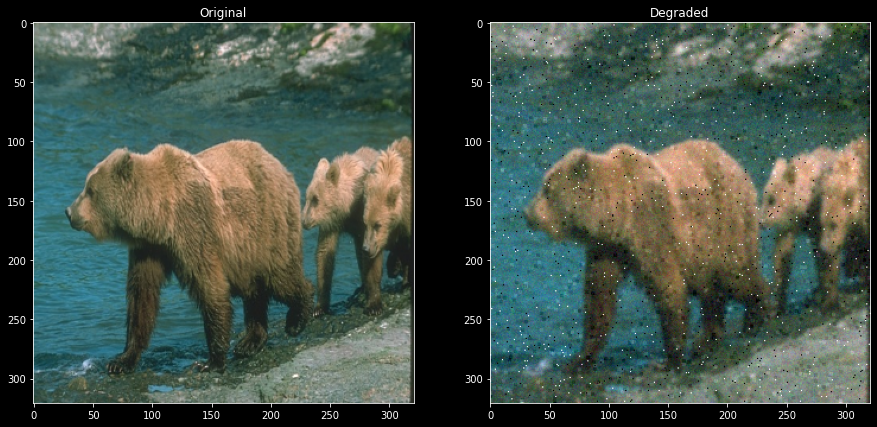

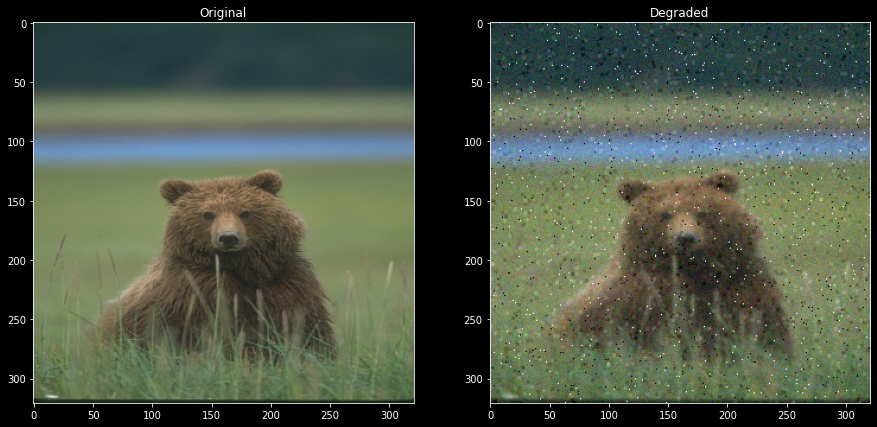

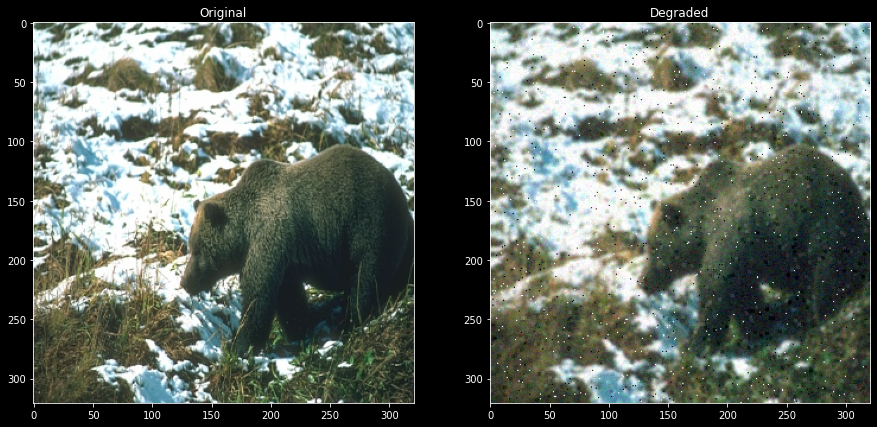

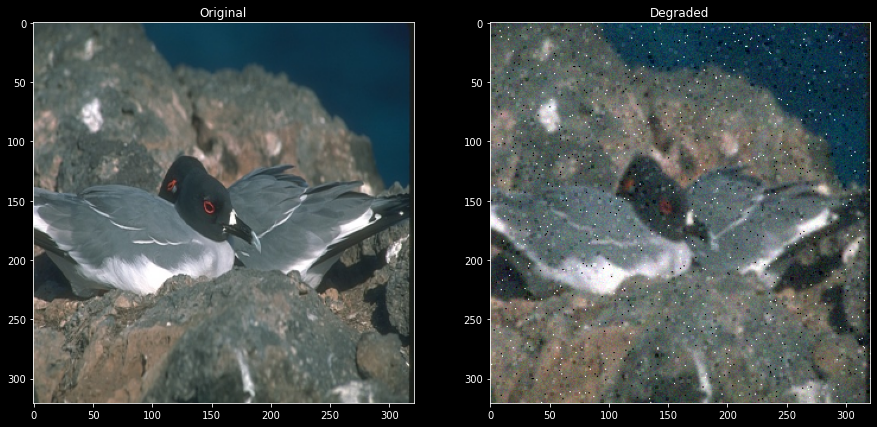

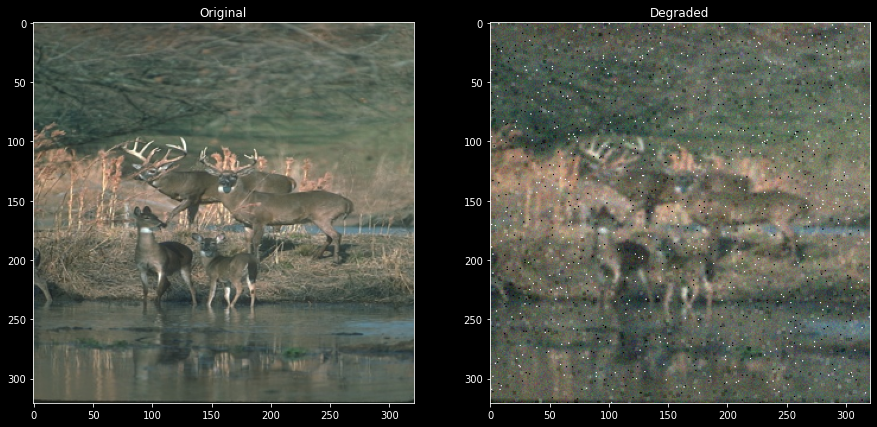

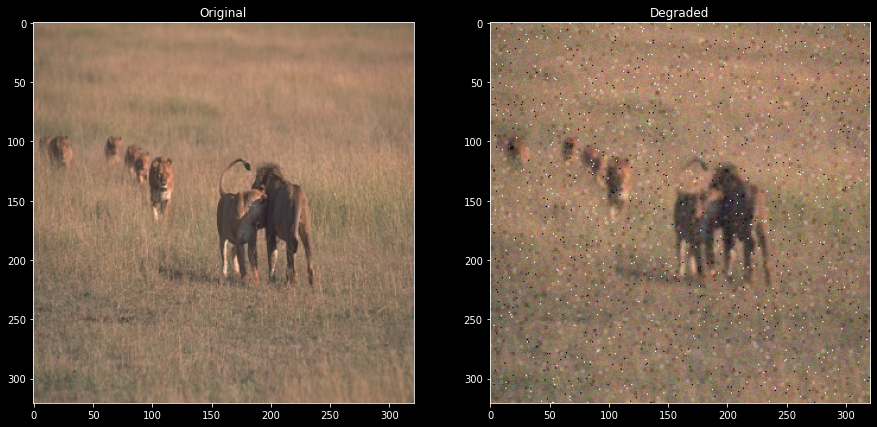

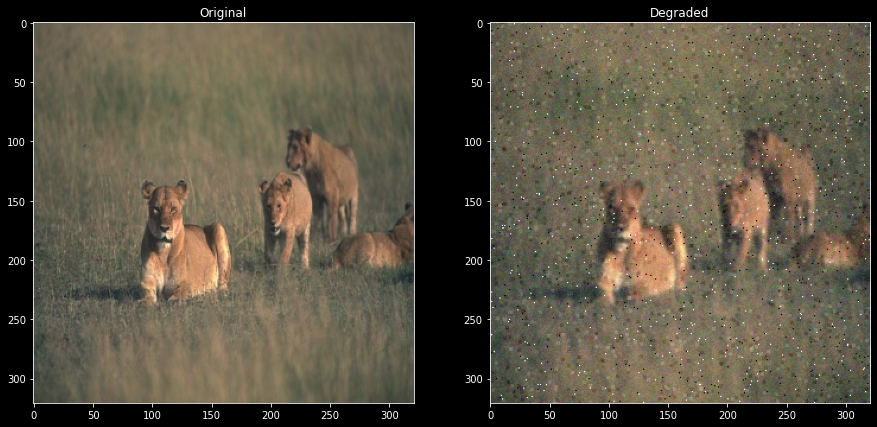

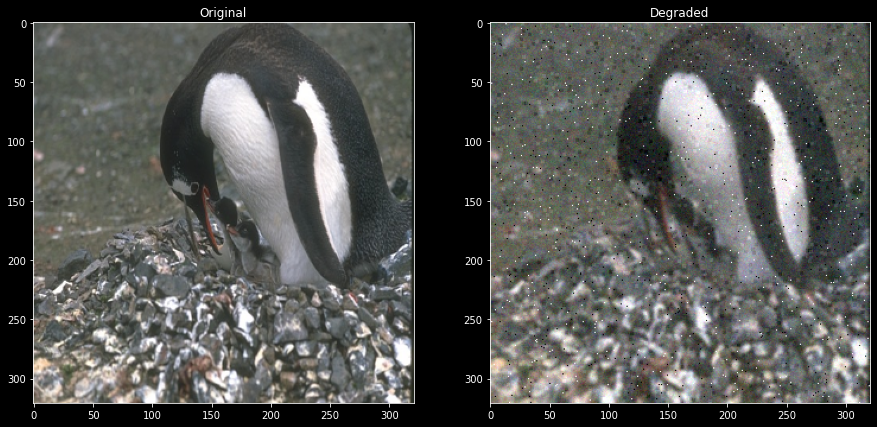

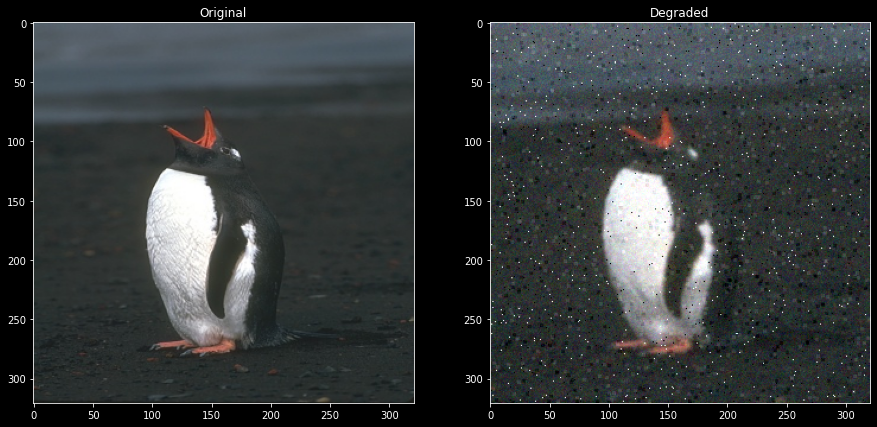

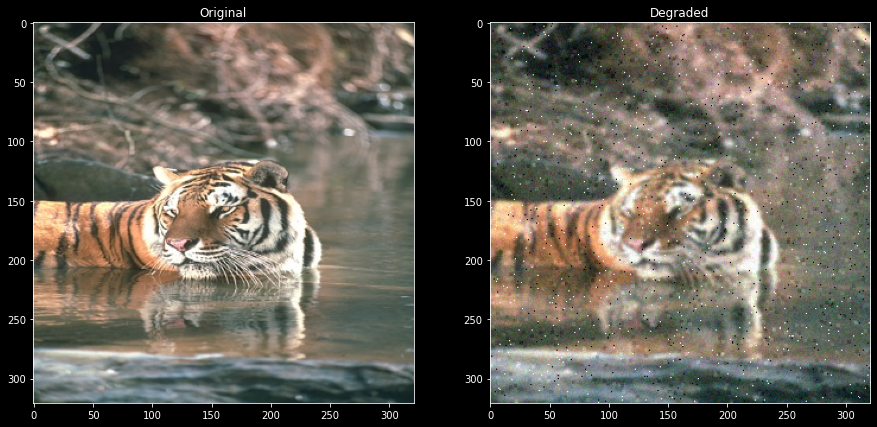

In [9]:
# Display the first 10 degraded images along with their original images
for i in range(10):
    plt.figure(figsize=(15,15))
    plt.subplot(1,2,1)
    plt.imshow(images[i])
    plt.title('Original')
    plt.subplot(1,2,2)
    plt.imshow(degraded_images[i])
    plt.title('Degraded')
    

### Hence, we can see that there is a clear degradation in the images.

### Extracting patches from the degraded images of size W = 23

In [10]:
## Extracting k random patches from the degraded images of size (W,W) and getting the central pixel of the patch from the original image for an image index

def get_random_patches(img_index, W, k):
    """ Function to get k random patches from the degraded images of size (W,W) and getting the central pixel of the patch from the original image for an image index

    Args:
        img_index (int): Index of the image from which the patches are to be extracted
        W (int): Width of the patch
        k (int): Number of patches to be extracted

    Returns:
        ndarray: Array of shape (k, W, W, 3) containing the k patches
    """
    patches = []
    central_pixels = []

    for i in range(0, img.shape[0] - W, W):
        for j in range(0, img.shape[1] - W, W):
            patch = degraded_images[img_index][i:i+W, j:j+W, :]
            patches.append(patch)
            central_pixels.append(images[img_index][i+W//2, j+W//2, :])


    # k random number from 1 to patches.shape[0]
    random_indices = np.random.randint(0, len(patches), k)

    # Randomly select k patches from the list of patches
    random_patches = [patches[i] for i in random_indices]
    random_central_pixels = [central_pixels[i] for i in random_indices]
    
    random_patches = np.array(random_patches)
    random_central_pixels = np.array(random_central_pixels)
    random_central_pixels = random_central_pixels.reshape(k,1,1,3)

    return random_patches, random_central_pixels

### Visualizing one of the patches and the corresponding center of the patch

In [11]:
patch, pixel =  get_random_patches(0, W, 10)

Text(0.5, 1.0, 'Random Patch')

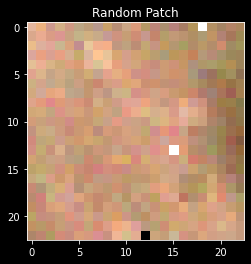

In [12]:
plt.imshow(patch[9])
plt.title('Random Patch')

Text(0.5, 1.0, 'Central Pixel of original image')

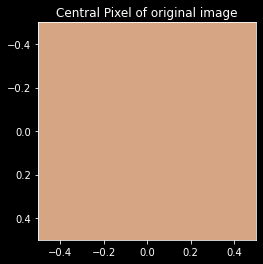

In [13]:
plt.imshow(pixel[9])
plt.title('Central Pixel of original image')

### Making patches of size W = 23 from the degraded images and the corresponding center of the patch

In [14]:
k = 50

In [15]:
patches = []
central_pixels = []

for i in range(len(degraded_images)):
    patch, pixel = get_random_patches(i, W, k)
    patches.append(patch)
    central_pixels.append(pixel)

patches = np.array(patches)
central_pixels = np.array(central_pixels)

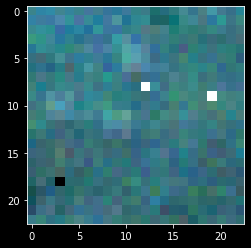

In [16]:
plt.imshow(patches[0][0])

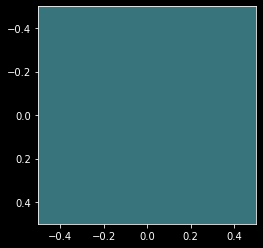

In [17]:
plt.imshow(central_pixels[0][0])

In [18]:
patches.shape

(200, 50, 23, 23, 3)

## Question 3

### Part a) We select w = 7

In [19]:
w = 7

### Part b) We use random forest regression to train the model

### Part c) 

In [20]:
## Function to read wxw patches from the degraded images and get the central pixel of the patch from the original image for an image index

def get_small_patches(patch,W, w):
    return patch[(W-w)//2:(W-w)//2+w, (W-w)//2:(W-w)//2+w, :]


### Visualizing a small patch of the degraded image

In [21]:
small_patch =  get_small_patches(patches[0][0], W, w)

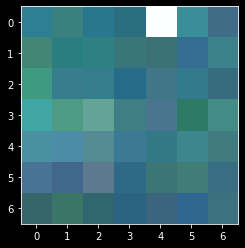

In [22]:
plt.imshow(small_patch)

In [23]:
## Get small_patches for all the patches

small_patches = []

for i in range(len(patches)):
    small_patch = []
    for j in range(len(patches[i])):
        small_patch.append(get_small_patches(patches[i][j], W, w))
    small_patches.append(small_patch)

small_patches = np.array(small_patches)
    

In [24]:
small_patches.shape

(200, 50, 7, 7, 3)

In [25]:
# Reshaping the small_patches and central_pixels 
small_patches = small_patches.reshape(200*k, w, w, 3)
central_pixels = central_pixels.reshape(200*k, 1, 1, 3)

In [26]:
# Shapes of the small_patches and central_pixels
print(small_patches.shape, central_pixels.shape)

(10000, 7, 7, 3) (10000, 1, 1, 3)


### Normalizing the small_patches channel-wise 

In [27]:
# Mean of all the Images
mean = np.mean(small_patches, axis=0)

In [28]:
# Std of all the images
std = np.std(small_patches, axis=0)

In [29]:
normalized_small_patches = (small_patches - mean) / std

### Normalizing the center_patch 

In [30]:
central_pixels_norm = central_pixels/255                    # Normalizing the central pixel value to range 0-1

In [31]:
## Flatten the normalized_small_patches and central_pixels_norm before passing them through the network

normalized_small_patches = normalized_small_patches.reshape(200*k, w*w*3)
central_pixels_norm = central_pixels_norm.reshape(200*k, 3)
small_patches_vector = small_patches.reshape(200*k, w*w*3)

In [32]:
# Split the data into train and validation sets

from sklearn.model_selection import train_test_split

central_pixels_norm_train, central_pixels_norm_val, small_patches_train, small_patches_val = train_test_split(central_pixels_norm, normalized_small_patches, test_size=0.2, random_state=42)

In [33]:
## Now we train a random forest regression model to predict the central pixel of the patch from the small_patches

from sklearn.ensemble import RandomForestRegressor

Regressor = RandomForestRegressor(n_estimators=500, random_state=0, n_jobs=-1)

Regressor.fit(small_patches_train, central_pixels_norm_train)


RandomForestRegressor(n_estimators=500, n_jobs=-1, random_state=0)

In [34]:
# Score of the model on training data
print("Training Score :" , str(Regressor.score(small_patches_train, central_pixels_norm_train)))

Training Score : 0.9924092073357532


In [35]:
# Import function for mean squared error
from sklearn.metrics import mean_squared_error

In [36]:
# The Score of the model on the validation set
print("Validation Score :", str(Regressor.score(small_patches_val, central_pixels_norm_val)))

# Print the MSE for the model on the validation set
print("MSE :", str(mean_squared_error(central_pixels_norm_val, Regressor.predict(small_patches_val))))

Validation Score : 0.9504372752357221
MSE : 0.0029635219391106


In [37]:
# Reconstruct the image from the small_patches and the predicted central pixel

img = degraded_images[0].astype(np.float32)

reconstruct_image = np.zeros((img.shape[0]-w, img.shape[1]-w, 3))
for x in range(0, img.shape[0] - w):
    vertical_patch = []
    for y in range(0, img.shape[1] - w):
        print("x = ", str(x), "y = ", str(y))
        patch = img[x:x+w, y:y+w, :]
        patch = (patch - mean) / std
        vertical_patch.append(patch)

    vertical_patch = np.array(vertical_patch)
    # Predict the central pixel of the patch
    central_pixel = Regressor.predict(vertical_patch.reshape(-1, w*w*3))

    # Concatanate the vertical_patch to the reconstruct_image
    reconstruct_image[x,:,:] = central_pixel

x =  0 y =  0
x =  0 y =  1
x =  0 y =  2
x =  0 y =  3
x =  0 y =  4
x =  0 y =  5
x =  0 y =  6
x =  0 y =  7
x =  0 y =  8
x =  0 y =  9
x =  0 y =  10
x =  0 y =  11
x =  0 y =  12
x =  0 y =  13
x =  0 y =  14
x =  0 y =  15
x =  0 y =  16
x =  0 y =  17
x =  0 y =  18
x =  0 y =  19
x =  0 y =  20
x =  0 y =  21
x =  0 y =  22
x =  0 y =  23
x =  0 y =  24
x =  0 y =  25
x =  0 y =  26
x =  0 y =  27
x =  0 y =  28
x =  0 y =  29
x =  0 y =  30
x =  0 y =  31
x =  0 y =  32
x =  0 y =  33
x =  0 y =  34
x =  0 y =  35
x =  0 y =  36
x =  0 y =  37
x =  0 y =  38
x =  0 y =  39
x =  0 y =  40
x =  0 y =  41
x =  0 y =  42
x =  0 y =  43
x =  0 y =  44
x =  0 y =  45
x =  0 y =  46
x =  0 y =  47
x =  0 y =  48
x =  0 y =  49
x =  0 y =  50
x =  0 y =  51
x =  0 y =  52
x =  0 y =  53
x =  0 y =  54
x =  0 y =  55
x =  0 y =  56
x =  0 y =  57
x =  0 y =  58
x =  0 y =  59
x =  0 y =  60
x =  0 y =  61
x =  0 y =  62
x =  0 y =  63
x =  0 y =  64
x =  0 y =  65
x =  0 y =  66
x =  

In [38]:
reconstruct_image = reconstruct_image*255
reconstruct_image = np.clip(reconstruct_image, 0, 255).astype(np.uint8)

Text(0.5, 1.0, 'Original Image')

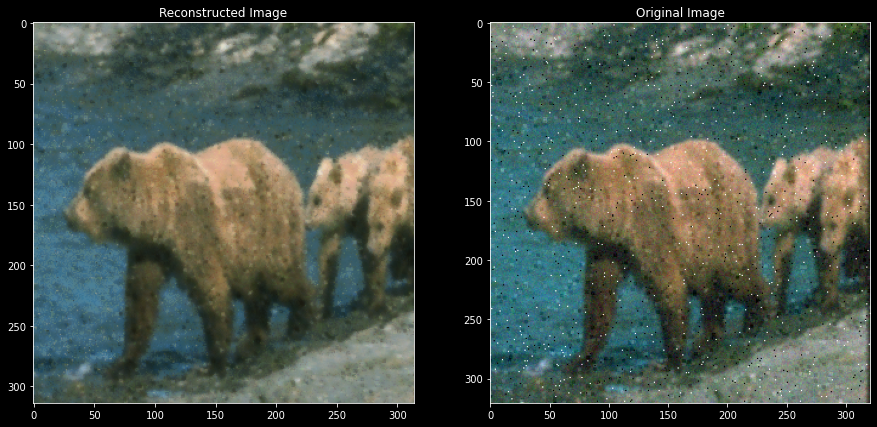

In [39]:
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(reconstruct_image)
plt.title("Reconstructed Image")

plt.subplot(1,2,2)
plt.imshow(degraded_images[0])
plt.title("Original Image")

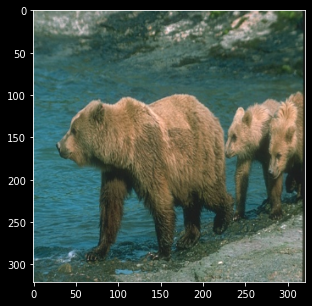

In [40]:
plt.figure(figsize=(5,5))
plt.imshow(images[0])

## The results look convincing. Hence we now move ahead with this approach

To test the models by different hyperparameters, we change the following hyperparameters:
- Number of trees in the random forest regression model
- Size of the small patches

For this we write a function for the entire training process 


In [41]:

def train(n_tree, w):
    # Get small patches of size w*w from the patches
    small_patches = []

    for i in range(len(patches)):
        small_patch = []
        for j in range(len(patches[i])):
            small_patch.append(get_small_patches(patches[i][j], W, w))
        small_patches.append(small_patch)

    small_patches = np.array(small_patches)

    # Reshaping the small_patches and central_pixels 
    small_patches = small_patches.reshape(200*k, w, w, 3)

    mean = np.mean(small_patches, axis=0)
    std = np.std(small_patches, axis=0)

    normalized_small_patches = (small_patches - mean)/std

    normalized_small_patches_vector = normalized_small_patches.reshape(200*k, w*w*3)

    # Split the data into train and validation sets
    central_pixels_norm_train, central_pixels_norm_val, small_patches_train, small_patches_val = train_test_split(central_pixels_norm, normalized_small_patches_vector, test_size=0.2, random_state=42)

    # Train the random forest regression model
    Regressor = RandomForestRegressor(n_estimators=n_tree, random_state=0, n_jobs=-1)

    Regressor.fit(small_patches_train, central_pixels_norm_train)

    # Score of the model on training data
    print("Training Score :" , str(Regressor.score(small_patches_train, central_pixels_norm_train)))

    # The Score of the model on the validation set
    print("Validation Score :", str(Regressor.score(small_patches_val, central_pixels_norm_val)))

    # Print the MSE for the model on the validation set
    print("MSE :", str(mean_squared_error(central_pixels_norm_val, Regressor.predict(small_patches_val))))

    # Print RMSE 
    print("RMSE :", str(np.sqrt(mean_squared_error(central_pixels_norm_val, Regressor.predict(small_patches_val)))))

    print("\n")

def inference(img_index, w):
    # Reconstruct the image from the small_patches and the predicted central pixel for image 0
    img = degraded_images[img_index].astype(np.float32)

    reconstruct_image = np.zeros((img.shape[0]-w, img.shape[1]-w, 3))
    for x in range(0, img.shape[0] - w):
        vertical_patch = []
        for y in range(0, img.shape[1] - w):
            patch = img[x:x+w, y:y+w, :]
            vertical_patch.append(patch)

        vertical_patch = np.array(vertical_patch)
        # Predict the central pixel of the patch
        central_pixel = Regressor.predict(vertical_patch.reshape(-1, w*w*3))

        # Concatanate the vertical_patch to the reconstruct_image
        reconstruct_image[x,:,:] = central_pixel
    
    reconstruct_image = np.clip(reconstruct_image, 0, 255).astype(np.uint8)

    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(reconstruct_image)
    plt.title("Reconstructed Image")

    plt.subplot(1,2,2)
    plt.imshow(degraded_images[img_index])
    plt.title("Original Image")


- ### N_esimators = [10, 50, 100, 200, 500, 1000]
- ### W = [5, 7, 9, 11, 13, 15, 17, 19]

In [42]:
n_estimators = [10, 50, 100, 200, 500, 1000]
w = [5,7,9,11,13,15,17,19]

In [43]:
# Change w keeping n_estimators = 100
for i in range(len(w)):
    print("w = ", str(w[i]))
    train(100, w[i])

w =  5
Training Score : 0.9920294245717501
Validation Score : 0.9497243877887901
MSE : 0.0030063500379341294
RMSE : 0.05483019275849876


w =  7
Training Score : 0.9920093060400251
Validation Score : 0.949602341651704
MSE : 0.0030138070708701802
RMSE : 0.05489815179830902


w =  9
Training Score : 0.9918446473584231
Validation Score : 0.948499647960125
MSE : 0.00307854360169166
RMSE : 0.05548462491259772


w =  11
Training Score : 0.9917702782946475
Validation Score : 0.9479956061459003
MSE : 0.003108978995001921
RMSE : 0.05575821908025687


w =  13
Training Score : 0.991694767582865
Validation Score : 0.9475577349738238
MSE : 0.003135112889145202
RMSE : 0.055992078807142014


w =  15
Training Score : 0.9916533744461894
Validation Score : 0.9476909961335643
MSE : 0.00312761300704857
RMSE : 0.05592506599950124


w =  17
Training Score : 0.9916129808336466
Validation Score : 0.9473760526204479
MSE : 0.003146303623990772
RMSE : 0.056091921200746644


w =  19
Training Score : 0.99152518455

### Hence we can see that we are getting the best results for w = 5  
### This is quite contradictory to my expectation. I expected the results to be better for bigger window sizes. However, we are getting lower RMSE values for w = 5. This, according to quite surprising!!

In [44]:
# Change n_estimators keeping w = 5
for i in range(len(n_estimators)):
    print("n_estimators = ", str(n_estimators[i]))
    train(n_estimators[i], 5)
    

n_estimators =  10
Training Score : 0.9881794424223513
Validation Score : 0.9434769732616916
MSE : 0.0033813463795975955
RMSE : 0.058149345478668936


n_estimators =  50
Training Score : 0.9916422889731926
Validation Score : 0.9488913526370987
MSE : 0.0030562391008586444
RMSE : 0.05528326239341021


n_estimators =  100
Training Score : 0.9920294245717501
Validation Score : 0.9497243877887901
MSE : 0.003006350037934128
RMSE : 0.05483019275849874


n_estimators =  200
Training Score : 0.9923097137500175
Validation Score : 0.9503370000726507
MSE : 0.002969830796937075
RMSE : 0.05449615396463382


n_estimators =  500
Training Score : 0.9924488554235463
Validation Score : 0.9506913371459295
MSE : 0.002948492130944507
RMSE : 0.054300019621953244


n_estimators =  1000
Training Score : 0.9924794520383141
Validation Score : 0.9507453359562709
MSE : 0.0029455474795078832
RMSE : 0.05427289820442504




### Hence, we are getting the best results for n_estimators = 1000

### I expected some moderate value of n_estimators to give better results. However, we are getting lower RMSE values for n_estimators = 1000, which is on the higher side. This, according to me is quite surprising!!

### <b> Optimal Parameters </b>
    
-    ### <b> w = 5 </b>  
-    ### <b> n_estimators = 1000 </b>    

## Question 4

In [45]:
# Training the model with n_estimators = 1000 and w = 5
w = 5
# Get small patches of size w*w from the patches
small_patches = []

for i in range(len(patches)):
    small_patch = []
    for j in range(len(patches[i])):
        small_patch.append(get_small_patches(patches[i][j], W, w))
    small_patches.append(small_patch)

small_patches = np.array(small_patches)

# Reshaping the small_patches and central_pixels 
small_patches = small_patches.reshape(200*k, w, w, 3)

mean = np.mean(small_patches, axis=0)
std = np.std(small_patches, axis=0)

small_patches = (small_patches - mean)/std

small_patches_vector = small_patches.reshape(200*k, w*w*3)  

# Split the data into train and validation sets
central_pixels_norm_train, central_pixels_norm_val, small_patches_train, small_patches_val = train_test_split(central_pixels_norm, small_patches_vector, test_size=0.2, random_state=42)

# Train the random forest regression model
Regressor_final = RandomForestRegressor(n_estimators=1000, random_state=0, n_jobs=-1)

Regressor_final.fit(small_patches_train, central_pixels_norm_train)

RandomForestRegressor(n_estimators=1000, n_jobs=-1, random_state=0)

## RESULT ON AN IMAGE FROM THE TRAINING DATASET

In [46]:
# Reconstruct the image from the small_patches and the predicted central pixel

img = degraded_images[0].astype(np.float32)

reconstruct_image = np.zeros((img.shape[0]-w, img.shape[1]-w, 3))
for x in range(0, img.shape[0] - w):
    vertical_patch = []
    for y in range(0, img.shape[1] - w):
        print("x = ", str(x), "y = ", str(y))
        patch = img[x:x+w, y:y+w, :]
        patch = (patch - mean)/std
        vertical_patch.append(patch)

    vertical_patch = np.array(vertical_patch)
    # Predict the central pixel of the patch
    central_pixel = Regressor_final.predict(vertical_patch.reshape(-1, w*w*3))

    # Concatanate the vertical_patch to the reconstruct_image
    reconstruct_image[x,:,:] = central_pixel

reconstruct_image = reconstruct_image*255
reconstruct_image = np.clip(reconstruct_image, 0, 255).astype(np.uint8)


x =  0 y =  0
x =  0 y =  1
x =  0 y =  2
x =  0 y =  3
x =  0 y =  4
x =  0 y =  5
x =  0 y =  6
x =  0 y =  7
x =  0 y =  8
x =  0 y =  9
x =  0 y =  10
x =  0 y =  11
x =  0 y =  12
x =  0 y =  13
x =  0 y =  14
x =  0 y =  15
x =  0 y =  16
x =  0 y =  17
x =  0 y =  18
x =  0 y =  19
x =  0 y =  20
x =  0 y =  21
x =  0 y =  22
x =  0 y =  23
x =  0 y =  24
x =  0 y =  25
x =  0 y =  26
x =  0 y =  27
x =  0 y =  28
x =  0 y =  29
x =  0 y =  30
x =  0 y =  31
x =  0 y =  32
x =  0 y =  33
x =  0 y =  34
x =  0 y =  35
x =  0 y =  36
x =  0 y =  37
x =  0 y =  38
x =  0 y =  39
x =  0 y =  40
x =  0 y =  41
x =  0 y =  42
x =  0 y =  43
x =  0 y =  44
x =  0 y =  45
x =  0 y =  46
x =  0 y =  47
x =  0 y =  48
x =  0 y =  49
x =  0 y =  50
x =  0 y =  51
x =  0 y =  52
x =  0 y =  53
x =  0 y =  54
x =  0 y =  55
x =  0 y =  56
x =  0 y =  57
x =  0 y =  58
x =  0 y =  59
x =  0 y =  60
x =  0 y =  61
x =  0 y =  62
x =  0 y =  63
x =  0 y =  64
x =  0 y =  65
x =  0 y =  66
x =  

### RESULTS

Text(0.5, 1.0, 'Noisy Image')

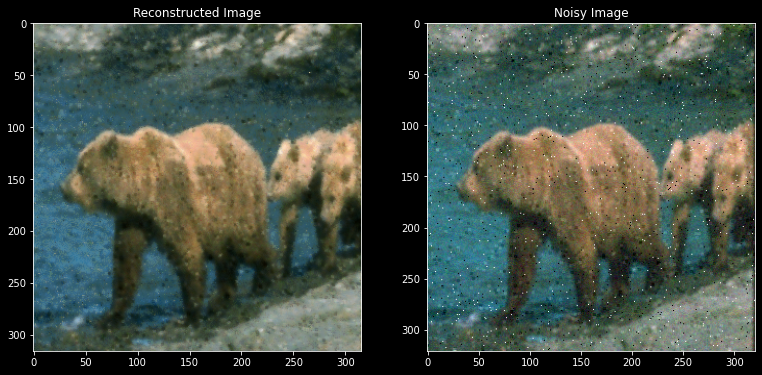

In [58]:
# Contrast streching

def contrast_streching(img):
    img = img.astype(np.float32)
    min_val = np.min(img)
    max_val = np.max(img)
    img = (img - min_val)/(max_val - min_val)
    img = np.uint8(img*255)
    return img

final_image = contrast_streching(reconstruct_image)

plt.figure(figsize=(20,20))
plt.subplot(1,3,1)
plt.imshow(final_image)
plt.title("Reconstructed Image")

plt.subplot(1,3,2)
plt.imshow(degraded_images[0])
plt.title("Noisy Image")

### GROUND TRUTH

Text(0.5, 1.0, 'Ground Truth Image')

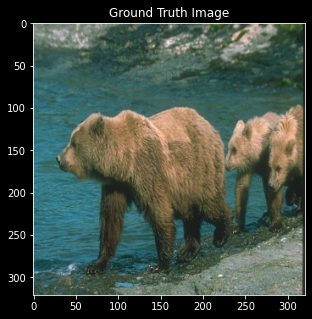

In [48]:
plt.figure(figsize=(5,5))
plt.imshow(images[0])
plt.title("Ground Truth Image")


Hence, we can see that the salt and pepper and gaussian noise is removed from the image while reconstruction. Hence, we can now try our model on the test dataset.

## RESULT ON IMAGES FROM TEST DATASET WITH SYNTHETIC NOISE

In [61]:
## Load the test images

test_image_path = "BSDS300\\images\\test"

test_images = load_images(test_image_path)
test_images = np.array(test_images)

# Randomly select two images fromt the test set
test_images = test_images[np.random.choice(len(test_images), 2, replace=False)]

# Adding synthetic noise to the test images
degraded_test_images = []

for i in range(len(test_images)):
    img = np.float32(test_images[i])
    for _ in range(2):
        # Randomly select a blur function index
        blur_index = np.random.randint(0, len(blurs))
        random_blur_kernel = 3

        if blur_index == 0:
            img = blurs[0](img, (random_blur_kernel, random_blur_kernel))
        elif blur_index == 1:
            img = blurs[1](img, ksize = (random_blur_kernel, random_blur_kernel), sigmaX = W)

        # Make random noise functions 
        Gaussian_noise = np.random.normal(0, 0.1, (size,size,3))*100

        # Make salt and pepper noise with probability 0.2
        salt_and_pepper_noise = np.zeros((size,size,3))

        # Make pixels of value 10 with 0.1 probability and -10 with 0.1 probability
        salt_and_pepper_noise[np.random.rand(size,size) < 0.005] = 200
        salt_and_pepper_noise[np.random.rand(size,size) < 0.005] = -200

        
        # Add noise to the blurred image
        img = img + Gaussian_noise  + salt_and_pepper_noise
    
    
    img = np.clip(img, 0, 255).astype(np.uint8)   # Clip and convert to uint8
    
    # Add the blurred and noisy image to the list of degraded images
    degraded_test_images.append(img)

### Visualizing the degraded image

Text(0.5, 1.0, 'Noisy Image 2')

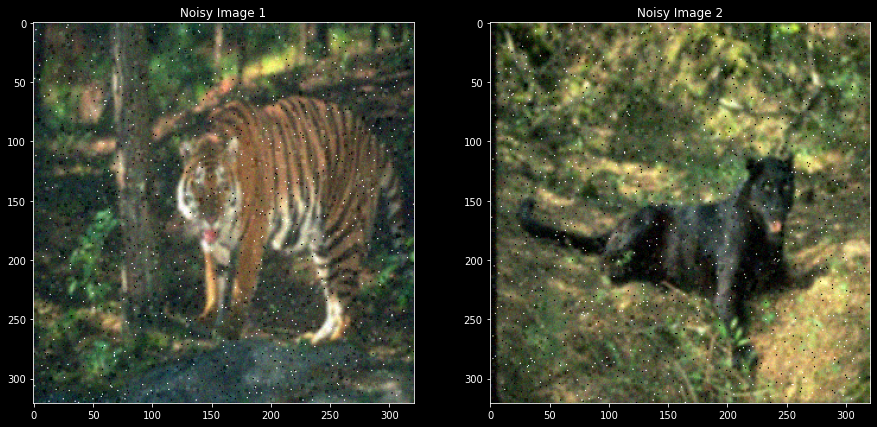

In [63]:
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(degraded_test_images[0])
plt.title("Noisy Image 1")

plt.subplot(1,2,2)
plt.imshow(degraded_test_images[1])
plt.title("Noisy Image 2")

In [64]:
# Reconstruct the image from the small_patches and the predicted central pixel

reconstructed_images = []

for i in range(len(degraded_test_images)):
    img = degraded_test_images[i].astype(np.float32)

    reconstruct_image = np.zeros((img.shape[0]-w, img.shape[1]-w, 3))
    for x in range(0, img.shape[0] - w):
        vertical_patch = []
        for y in range(0, img.shape[1] - w):
            print("x = ", str(x), "y = ", str(y))
            patch = img[x:x+w, y:y+w, :]
            patch = (patch - mean)/std
            vertical_patch.append(patch)

        vertical_patch = np.array(vertical_patch)
        # Predict the central pixel of the patch
        central_pixel = Regressor_final.predict(vertical_patch.reshape(-1, w*w*3))

        # Concatanate the vertical_patch to the reconstruct_image
        reconstruct_image[x,:,:] = central_pixel

    reconstruct_image = reconstruct_image*255
    reconstruct_image = np.clip(reconstruct_image, 0, 255).astype(np.uint8)

    reconstructed_images.append(reconstruct_image)

x =  0 y =  0
x =  0 y =  1
x =  0 y =  2
x =  0 y =  3
x =  0 y =  4
x =  0 y =  5
x =  0 y =  6
x =  0 y =  7
x =  0 y =  8
x =  0 y =  9
x =  0 y =  10
x =  0 y =  11
x =  0 y =  12
x =  0 y =  13
x =  0 y =  14
x =  0 y =  15
x =  0 y =  16
x =  0 y =  17
x =  0 y =  18
x =  0 y =  19
x =  0 y =  20
x =  0 y =  21
x =  0 y =  22
x =  0 y =  23
x =  0 y =  24
x =  0 y =  25
x =  0 y =  26
x =  0 y =  27
x =  0 y =  28
x =  0 y =  29
x =  0 y =  30
x =  0 y =  31
x =  0 y =  32
x =  0 y =  33
x =  0 y =  34
x =  0 y =  35
x =  0 y =  36
x =  0 y =  37
x =  0 y =  38
x =  0 y =  39
x =  0 y =  40
x =  0 y =  41
x =  0 y =  42
x =  0 y =  43
x =  0 y =  44
x =  0 y =  45
x =  0 y =  46
x =  0 y =  47
x =  0 y =  48
x =  0 y =  49
x =  0 y =  50
x =  0 y =  51
x =  0 y =  52
x =  0 y =  53
x =  0 y =  54
x =  0 y =  55
x =  0 y =  56
x =  0 y =  57
x =  0 y =  58
x =  0 y =  59
x =  0 y =  60
x =  0 y =  61
x =  0 y =  62
x =  0 y =  63
x =  0 y =  64
x =  0 y =  65
x =  0 y =  66
x =  

### RESULT 1

Text(0.5, 1.0, 'Noisy Image 1')

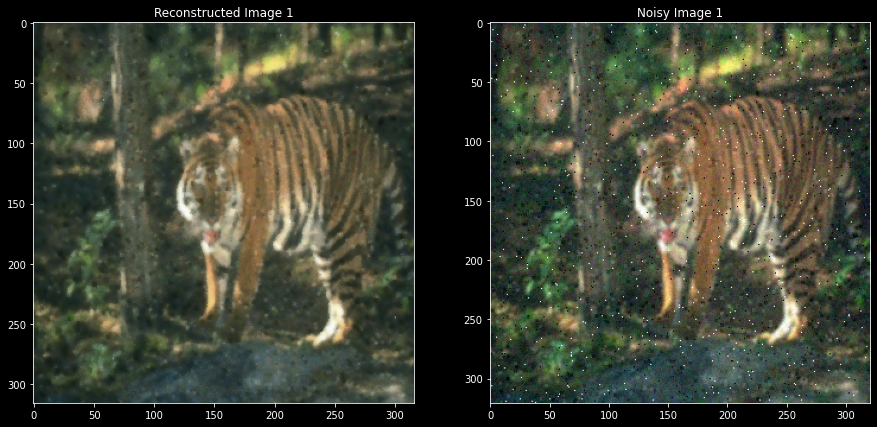

In [68]:
final_image = contrast_streching(reconstructed_images[0])

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(reconstructed_images[0])
plt.title("Reconstructed Image 1")

plt.subplot(1,2,2)
plt.imshow(degraded_test_images[0])
plt.title("Noisy Image 1")


### RESULT 2

Text(0.5, 1.0, 'Noisy Image 2')

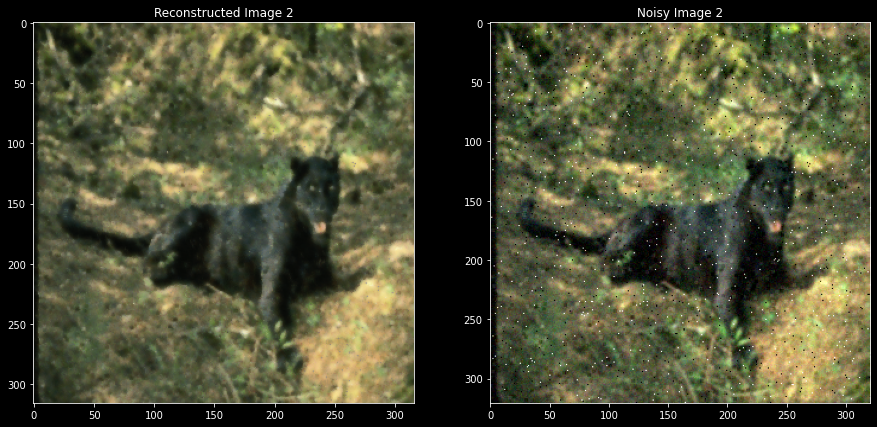

In [69]:
final_image = contrast_streching(reconstructed_images[1])

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(reconstructed_images[1])
plt.title("Reconstructed Image 2")

plt.subplot(1,2,2)
plt.imshow(degraded_test_images[1])
plt.title("Noisy Image 2")

### THE RESULTING RECONSTRUCTED IMAGES LOOK GOOD. THE GAUSSIAN AND SALT & PEPPER NOISE IS REMOVED FROM THE IMAGE.

## RESULT ON IMAGES WITH POOR QUALITY

In [70]:
noisy_image_path = "Noisy_images"

noisy_images = load_images(noisy_image_path)

### Visualizing the noisy images

Text(0.5, 1.0, 'Noisy Image 2')

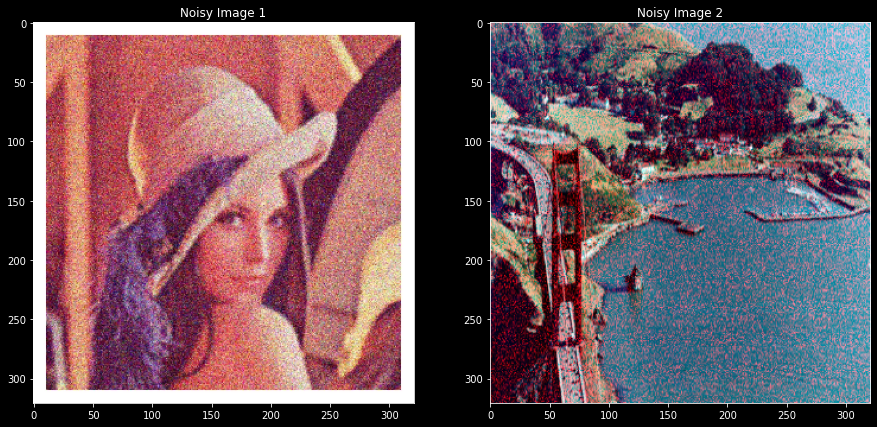

In [71]:
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(noisy_images[0])
plt.title("Noisy Image 1")

plt.subplot(1,2,2)
plt.imshow(noisy_images[1])
plt.title("Noisy Image 2")

In [72]:
# Reconstruct the image from the small_patches and the predicted central pixel

reconstructed_images = []

for i in range(len(noisy_images)):
    img = noisy_images[i].astype(np.float32)

    reconstruct_image = np.zeros((img.shape[0]-w, img.shape[1]-w, 3))
    for x in range(0, img.shape[0] - w):
        vertical_patch = []
        for y in range(0, img.shape[1] - w):
            print("x = ", str(x), "y = ", str(y))
            patch = img[x:x+w, y:y+w, :]
            patch = (patch - mean)/std
            vertical_patch.append(patch)

        vertical_patch = np.array(vertical_patch)
        # Predict the central pixel of the patch
        central_pixel = Regressor_final.predict(vertical_patch.reshape(-1, w*w*3))

        # Concatanate the vertical_patch to the reconstruct_image
        reconstruct_image[x,:,:] = central_pixel

    reconstruct_image = reconstruct_image*255
    reconstruct_image = np.clip(reconstruct_image, 0, 255).astype(np.uint8)

    reconstructed_images.append(reconstruct_image)

x =  0 y =  0
x =  0 y =  1
x =  0 y =  2
x =  0 y =  3
x =  0 y =  4
x =  0 y =  5
x =  0 y =  6
x =  0 y =  7
x =  0 y =  8
x =  0 y =  9
x =  0 y =  10
x =  0 y =  11
x =  0 y =  12
x =  0 y =  13
x =  0 y =  14
x =  0 y =  15
x =  0 y =  16
x =  0 y =  17
x =  0 y =  18
x =  0 y =  19
x =  0 y =  20
x =  0 y =  21
x =  0 y =  22
x =  0 y =  23
x =  0 y =  24
x =  0 y =  25
x =  0 y =  26
x =  0 y =  27
x =  0 y =  28
x =  0 y =  29
x =  0 y =  30
x =  0 y =  31
x =  0 y =  32
x =  0 y =  33
x =  0 y =  34
x =  0 y =  35
x =  0 y =  36
x =  0 y =  37
x =  0 y =  38
x =  0 y =  39
x =  0 y =  40
x =  0 y =  41
x =  0 y =  42
x =  0 y =  43
x =  0 y =  44
x =  0 y =  45
x =  0 y =  46
x =  0 y =  47
x =  0 y =  48
x =  0 y =  49
x =  0 y =  50
x =  0 y =  51
x =  0 y =  52
x =  0 y =  53
x =  0 y =  54
x =  0 y =  55
x =  0 y =  56
x =  0 y =  57
x =  0 y =  58
x =  0 y =  59
x =  0 y =  60
x =  0 y =  61
x =  0 y =  62
x =  0 y =  63
x =  0 y =  64
x =  0 y =  65
x =  0 y =  66
x =  

### RESULT 1

Text(0.5, 1.0, 'Noisy Image 1')

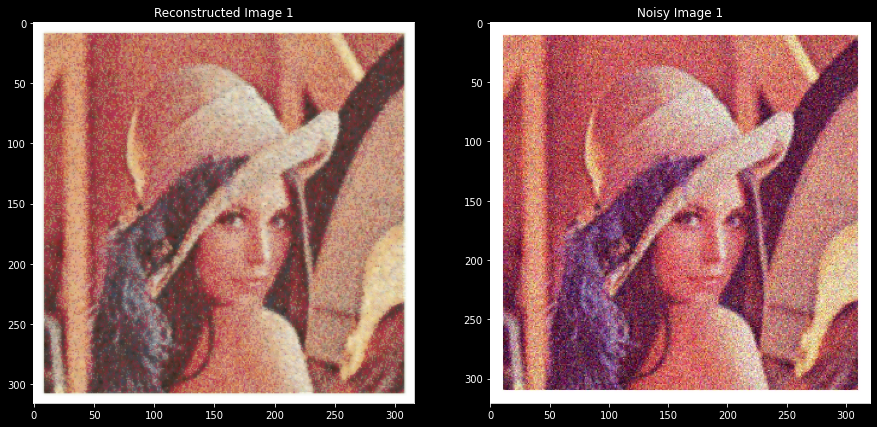

In [73]:
final_image = contrast_streching(reconstructed_images[0])

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(reconstructed_images[0])
plt.title("Reconstructed Image 1")

plt.subplot(1,2,2)
plt.imshow(noisy_images[0])
plt.title("Noisy Image 1")

### RESULT 2

Text(0.5, 1.0, 'Noisy Image 1')

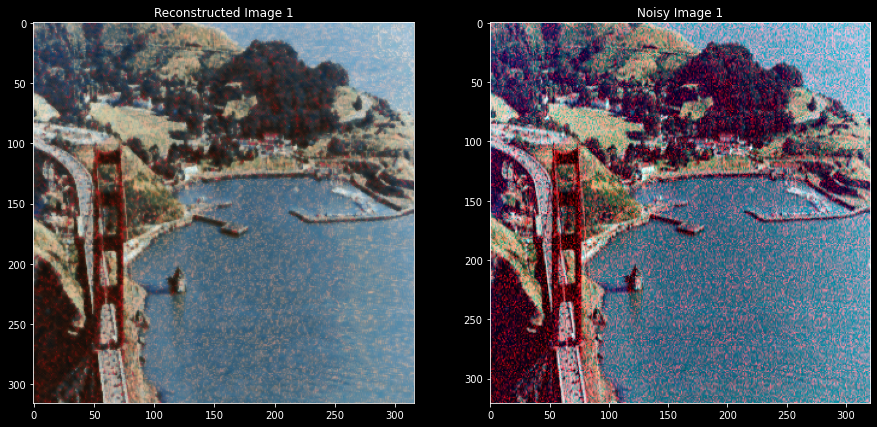

In [74]:
final_image = contrast_streching(reconstructed_images[1])

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(reconstructed_images[1])
plt.title("Reconstructed Image 1")

plt.subplot(1,2,2)
plt.imshow(noisy_images[1])
plt.title("Noisy Image 1")

### Both the results look really good, the gaussian and salt and pepper noise is removed from the image. Hence, we can say that the model is working well.

# FINAL DISCUSSION OF THE RESULTS OBTAINED IN THE ASSIGNMENT

### a) Design Choices

- The W used for the assignment was 23. This choice was made as having a bigger largest window size allowed me to try various values of w, giving me the flexibility to try different values of w and then checking the results.
- Noise Models used: Gaussian, Salt and Pepper
- Blur Models used: Simple Blur, Gaussian Blur
- ML model used: Random Forest Regression
Using Random Forest over SVM was an obvious choice since, usually for higher dimensional problems, Random Forest Regression is usually more accurate than SVM. (According to resource [1])   
Initially I was planning to test neural networks also for the assignment. However, since the results I got using the Random Forest Regression model were good, I decided to stick with the same model and vary the hyperparameters, complexity of the model and the size of the window to get better results.
- Hyperparameters varied:
    - Number of trees in the random forest regression model
    - Size of the small patches

### b) Initial Guesses

- My initial guess was that larger values of w with a moderate number of n_estimators would give better results. 
- Using Random Forest against SVM or Logistic Regression would give better results.

### c) Observations

- The model seems to be working well for the degraded images. The gaussian and salt and pepper noise is removed from the image. However, sharpening isn't that great in the results, however, still the results are quite good
- w = 5 gives the best results. <b> This is quite contradictory to my expectation. I expected the results to be better for bigger window sizes. However, we are getting lower RMSE values for w = 5. This, according to quite surprising!! </b>
- n_estimators = 1000 gives the best results. <b> Again I expected some moderate value of n_estimators to give better results. However, we are getting lower RMSE values for n_estimators = 1000, which is on the higher side. This, according to me is quite surprising!! </b>

### d) Justifying the surprising results

- The larger windows perhaps results in adding redundant information. Hence, in those cases the ML model didn't train well. Maybe a more complex model will learn better give more features, however, this wasn't the case for our observations.

- Maybe n_estimators = 1000 is not too high for this situation. Inreasing the values further, may start giving diminishing returns.

## RESOURCES
[1] https://datascience.stackexchange.com/questions/6838/when-to-use-random-forest-over-svm-and-vice-versa#:~:text=random%20forests%20are%20more%20likely,beyond%2010%20000%20data%20points.

[2] https://github.com/TheShiningVampire/Machine_Learning_Udemy/tree/master/Bulldozer_price_regression
I have earlier used the random forest regression model in other project. So, I used some parts of it for reference.

[3] https://youtu.be/POv-1DCPGsE : Lecture by Prof. Amit Sethi on Machine Learning

[4] Code Snippets provided by Prof. Amit Sethi for extracting patches

[5] https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html